# Analyse single cell RNA seqeuncing and CITE sequencing on human head and neck cancer

#### File name: Bald-scRNAseq-HNSCC.R.ipynb
#### Date created: 20210513
#### Programmer: Chang
#### Reference

[Chapter 3 Heatmap Annotations](https://jokergoo.github.io/ComplexHeatmap-reference/book/heatmap-annotations.html)

[Changing R plot options in Jupyter](https://notebook.community/andrie/jupyter-notebook-samples/Changing%20R%20plot%20options%20in%20Jupyter)

[Changing R plot options in Jupyter](https://notebook.community/andrie/jupyter-notebook-samples/Changing%20R%20plot%20options%20in%20Jupyter)

[Using a new windows version of R in Jupyter notebooks](https://stackoverflow.com/questions/51647561/using-a-new-windows-version-of-r-in-jupyter-notebooks)

[scRNAseq_Braun_etal_Immunity_Script.Rmd](https://github.com/BaldLab/2020_Braun_et_al_CD226_Immunity/blob/master/scRNAseq_Mouse/R/scRNAseq_Braun_etal_Immunity_Script.Rmd)

[Introduction to scRNA-seq integration](https://satijalab.org/seurat/articles/integration_introduction.html)

[Using dittoSeq to visualize (sc)RNAseq data](https://bioconductor.org/packages/devel/bioc/vignettes/dittoSeq/inst/doc/dittoSeq.html)

[Setup a Seurat object, add the RNA and protein data](https://satijalab.org/seurat/articles/multimodal_vignette.html)

[scRNA-seq/lessons](https://github.com/hbctraining/scRNA-seq/tree/master/lessons)

[How to solve Error: cannot allocate vector of size 1.2 Gb in R?](https://www.researchgate.net/post/How_to_solve_Error_cannot_allocate_vector_of_size_12_Gb_in_R)

In [1]:
dir.C <- "C:"

dir.R.packages <- "C:/Program Files/R/R-4.0.3/library" #"C:/Program Files/R/R-4.0.2/library"

library(dplyr, lib.loc = dir.R.packages)


Attaching package: 'dplyr'


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union




In [2]:
dir.Bald.scRNA.202002.analysis <- "E:/backup-genomeinfo/share/analysis/Bald_-_RNASeq/scRNA_Feb2020_CITE_VDJ/GEX_CiteSeq/analysis-results"

In [3]:
# merged_seurat <- readRDS(file = file.path(dir.Bald.scRNA.202002.analysis,"merged_seurat.rds"))

GEX1 <- readRDS(file = file.path(dir.Bald.scRNA.202002.analysis,"Bald-HNSCC-scRNAseq-CITEseq_filtered_ADT-quantiledGEX1.rds"))
GEX2 <- readRDS(file = file.path(dir.Bald.scRNA.202002.analysis,"Bald-HNSCC-scRNAseq-CITEseq_filtered_ADT-quantiledGEX2.rds")) 
GEX3 <- readRDS(file = file.path(dir.Bald.scRNA.202002.analysis,"Bald-HNSCC-scRNAseq-CITEseq_filtered_ADT-quantiledGEX3.rds")) 
GEX4 <- readRDS(file = file.path(dir.Bald.scRNA.202002.analysis,"Bald-HNSCC-scRNAseq-CITEseq_filtered_ADT-quantiledGEX4.rds")) # class(GEX4)

# Edit meta data
GEX1@meta.data$condition <- "unstimulated"
GEX2@meta.data$condition <- "unstimulated"
GEX3@meta.data$condition <- "stimulated"
GEX4@meta.data$condition <- "stimulated"

Loading required package: SeuratObject

Warning message:
"package 'SeuratObject' was built under R version 4.0.5"


In [4]:
# Merge all samples of the same tissue type
merged_seurat <- merge( x=GEX1
                        ,y=c(GEX2, GEX3, GEX4))

Warning message in CheckDuplicateCellNames(object.list = objects):
"Some cell names are duplicated across objects provided. Renaming to enforce unique cell names."


Keys to Seurat elements rna_ adt_

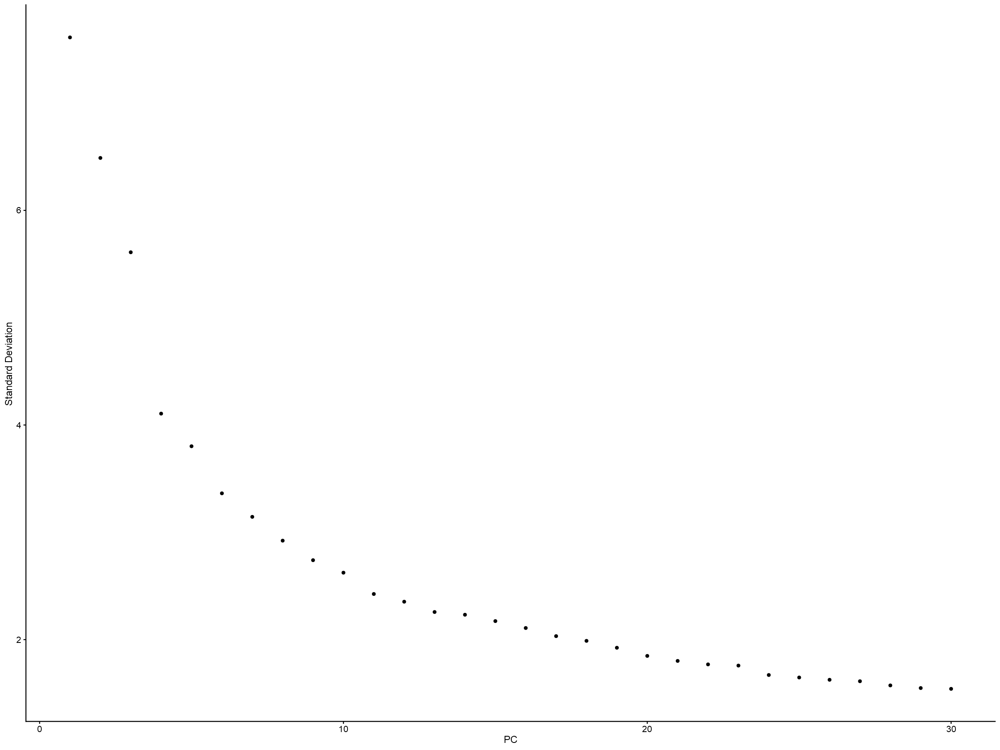

In [5]:
#---------------------------------------------------------------------------------------------------------------
# Cluster cells on the basis of their scRNA-seq profiles
## reference [Using Seurat with multimodal data](https://satijalab.org/seurat/articles/multimodal_vignette.html)
#---------------------------------------------------------------------------------------------------------------

# View the keys for all keyed components (assays, dimensional reduction, spatial images) of a Seurat object using the Key functio
cat("Keys to Seurat elements",Seurat::Key(merged_seurat))
#    RNA    ADT 
# "rna_" "adt_" 

# DefaultAssay(merged_seurat) # "RNA"
merged_seurat <- Seurat::NormalizeData(object = merged_seurat
                                       ,assay="RNA"
                                       ,verbose=FALSE) %>%
  Seurat::FindVariableFeatures(verbose=FALSE) %>%
  Seurat::ScaleData(verbose=FALSE) %>%
  Seurat::RunPCA(verbose=FALSE)

# Change default R plot size
options(repr.plot.width = 4*5, repr.plot.height = 3*5)

# Clustering and dimension (PCs) selection
# Check dimensions
## A dimension is a PC. Choose PC23 as the break point. Take the more conservative PC.
Seurat::ElbowPlot(object = merged_seurat
                  ,ndims = 30
                  ,reduction = "pca")

In [6]:
merged_seurat <- Seurat::FindNeighbors(object = merged_seurat, dims=1:23, verbose=FALSE)

merged_seurat <- Seurat::FindClusters(object = merged_seurat, resolution=c(0.5, 0.9), verbose=FALSE)

merged_seurat <- Seurat::RunTSNE(merged_seurat, assay="RNA",dims=1:23, verbose=FALSE) 

merged_seurat <- Seurat::RunUMAP(merged_seurat, assay="RNA", dims=1:23, verbose=FALSE)

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"


Visualising clustering by t-SNE

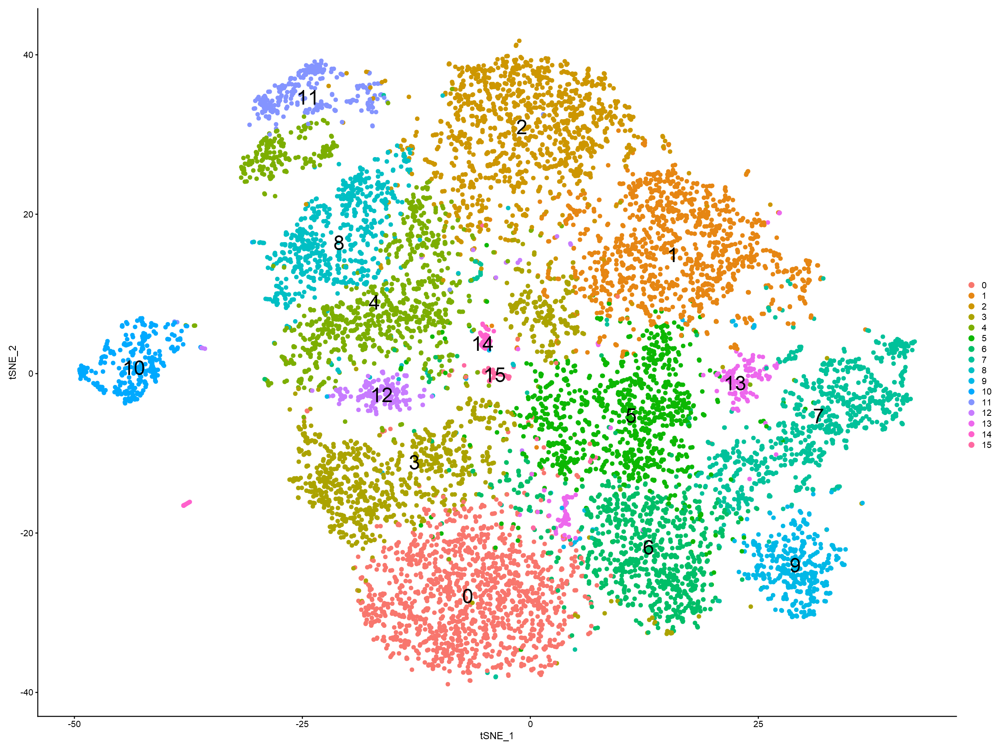

In [7]:
expansion.factor <- 5
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 3*expansion.factor)
cat("Visualising clustering by t-SNE")
Seurat::DimPlot(merged_seurat, reduction = "tsne", label = TRUE, pt.size=2, label.size=10)

Visualising clustering by UMAP

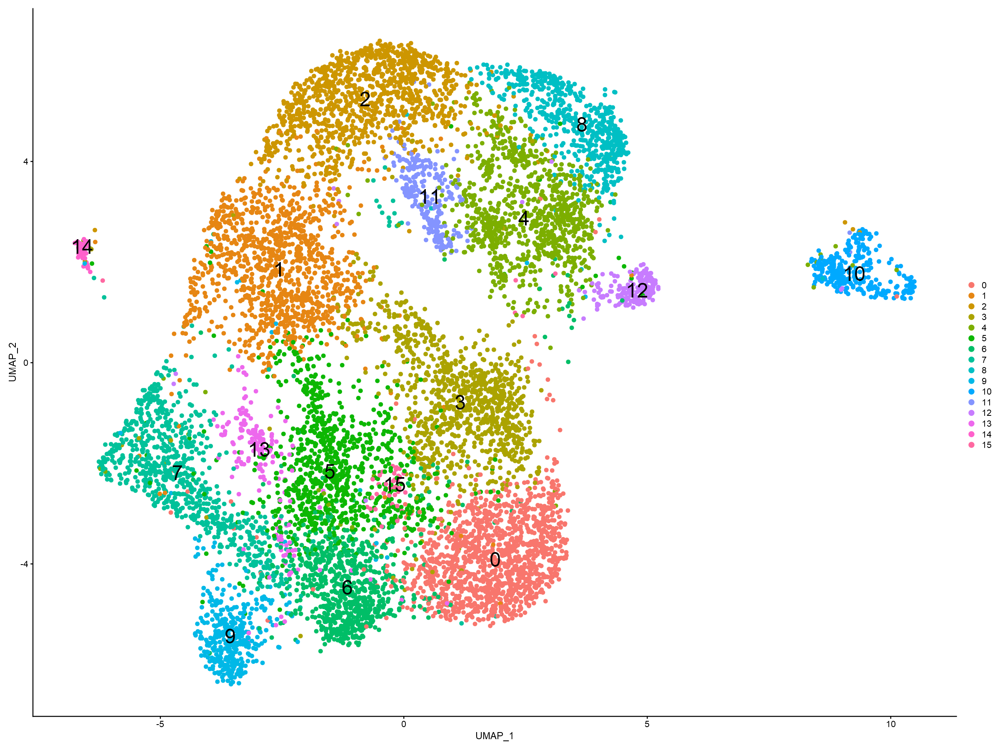

In [8]:
cat("Visualising clustering by UMAP")
Seurat::DimPlot(merged_seurat, reduction = "umap", label = TRUE, pt.size=2, label.size=10)

In [9]:
#-------------------------
# Normalise assay ADT
#-------------------------
merged_seurat <- Seurat::NormalizeData(object = merged_seurat
                                       , normalization.method="CLR"
                                       , assay="ADT"
                                       , margin=2 # normalise data across features (margin=1) or cells (margin=2)
                                       , verbose=FALSE
                                       ) %>%
  Seurat::ScaleData(verbose=FALSE) %>%
  Seurat::RunPCA(reduction.name='adtpca',verbose=FALSE)

Warning message:
"Cannot add objects with duplicate keys (offending key: PC_), setting key to 'adtpca_'"


In [10]:
#-------------------------------------------
# Visualize multiple modalities side-by-side
#-------------------------------------------
# Find out the prefixes of different assays
## Features (i.e., genes, protein) can be referred as assayKey_featureName
Seurat::Key(merged_seurat[["RNA"]]) # [1] "rna_"
Seurat::Key(merged_seurat[["ADT"]]) # [1] "adt_"

# Compare gene expression between conditions and clusters
genes.selected <- c("CD226","PDCD1","CD28","ENTPD1","CD96","TIGIT") # ,"EOMES"
genes.selected %in% rownames(merged_seurat) # Should be all TRUE
genes.selected.RNA <- paste0(Seurat::Key(merged_seurat[["RNA"]]), genes.selected) # Include only genes that can be found in the rownames() # ,"CD279" ,"CD39"

# protein feature names
protein.selected <- rownames(merged_seurat@assays$ADT)
protein.selected.ADT <- paste0(Seurat::Key(merged_seurat[["ADT"]]), protein.selected)

[1] "rna_"

[1] "adt_"

[1] TRUE TRUE TRUE TRUE TRUE TRUE

Compare gene expression of all genes between conditions stimulated and unstimulated

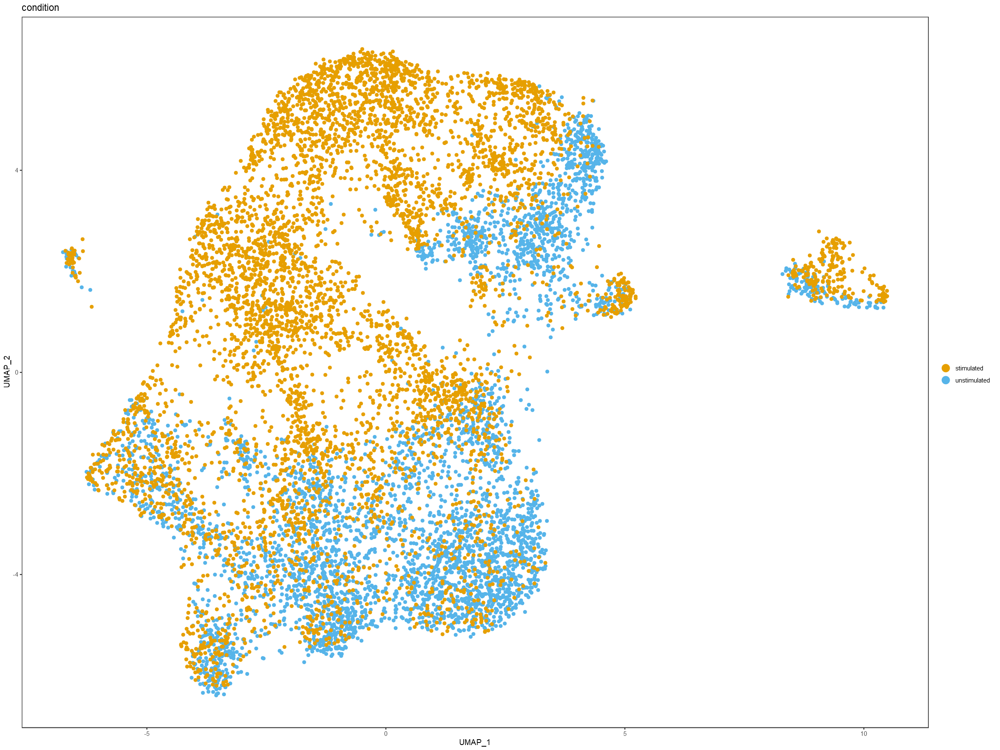

In [11]:
# Compare gene expression of all genes between conditions
cat("Compare gene expression of all genes between conditions stimulated and unstimulated")
dittoSeq::dittoDimPlot(object=merged_seurat
                       ,var = "condition"
                       ,reduction.use = "umap"
                       ,assay = "RNA"
                      ,size=2)

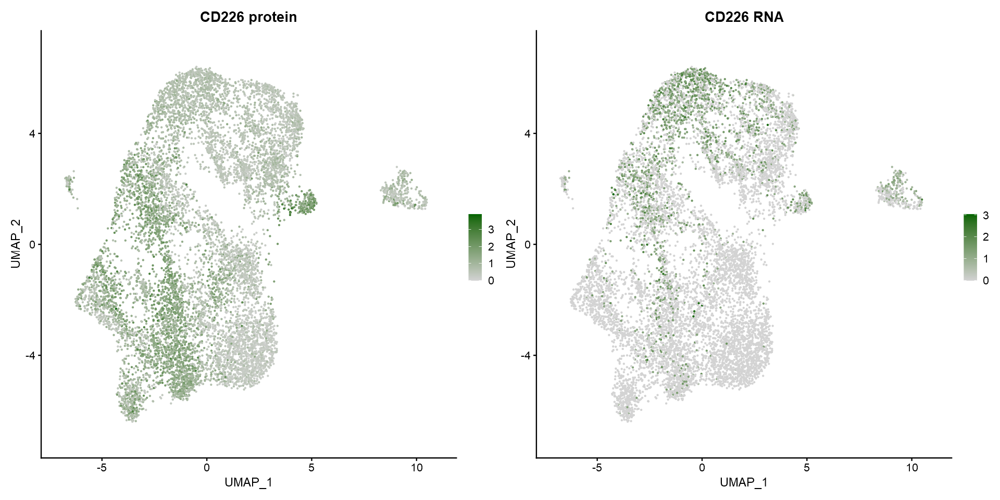

In [12]:
# Plot expression of CD226 at protein and RNA levels
## gene name is specified as assayName_featureName (e.g., rna_CD226, adtcd226_CD226)
featurePlot.1.rnaCD226 <- Seurat::FeaturePlot(object = merged_seurat
                                              ,features = genes.selected.RNA[1]
                                              , cols = c("lightgrey", "darkgreen")) + ggplot2::ggtitle("CD226 RNA")

featurePlot.1.adtCD226 <- Seurat::FeaturePlot(object = merged_seurat
                                              ,features = protein.selected.ADT[1]
                                              , cols = c("lightgrey", "darkgreen")) + ggplot2::ggtitle("CD226 protein")
# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 2*expansion.factor)

featurePlot.1.adtCD226 | featurePlot.1.rnaCD226

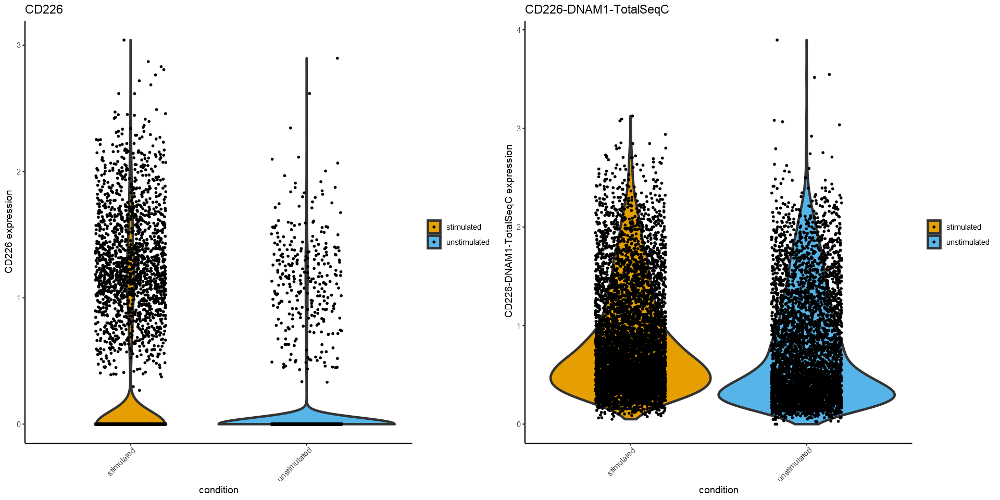

In [13]:
#------------------------------------------------
# Expression of single gene between conditions in assay RNA
#------------------------------------------------
## Arrange multiple violin plots into a grid using cowplot::plot_grid()
cowplot::plot_grid(
     dittoSeq::dittoPlot(object=merged_seurat
                    ,var=genes.selected[1] # var argument cannot take assayName_featureName
                    ,assay = "RNA"
                    ,group.by = "condition"
                    ,plots = c("vlnplot", "jitter"))
    ,dittoSeq::dittoPlot(object=merged_seurat
                    ,var=protein.selected[1]
                    ,assay = "ADT"
                    ,group.by = "condition"
                    ,plots = c("vlnplot", "jitter"))
    ,ncol=2)

Violin plots for expression levels of RNA and protein side by side

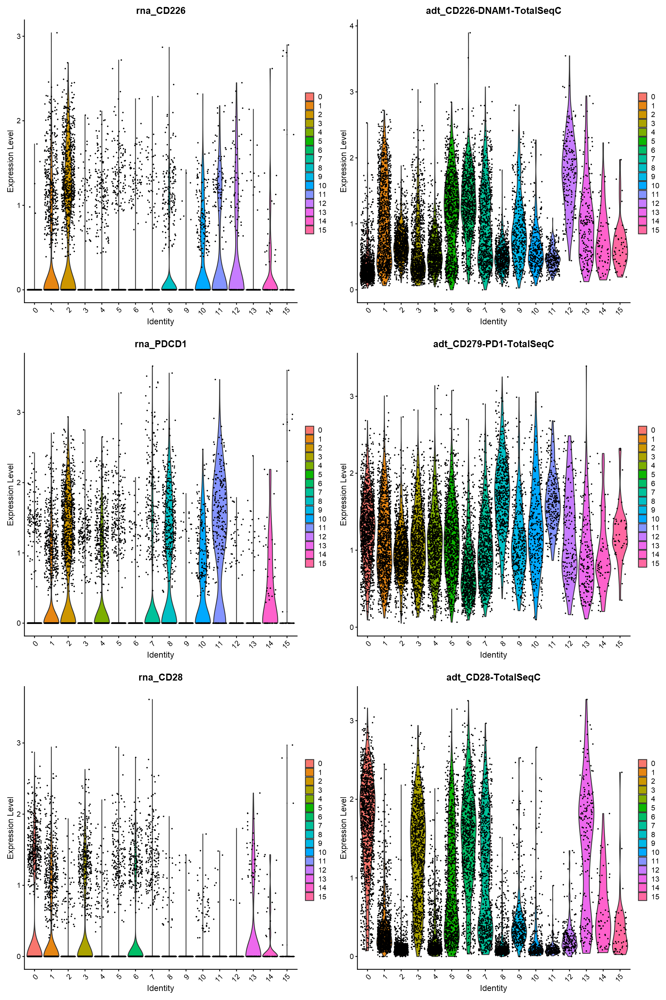

In [14]:
# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 6*expansion.factor)

# Plot RNA and protein side by side
cat("Violin plots for expression levels of RNA and protein side by side")
## Arrange multiple violin plots into a grid using cowplot::plot_grid()
cowplot::plot_grid(
  # CD226 RNA and protein
   Seurat::VlnPlot(object=merged_seurat, features = genes.selected.RNA[1])
  ,Seurat::VlnPlot(object=merged_seurat, features = protein.selected.ADT[1])
  # PDCD1 RNA and protein CD279-PD1-TotalSeqC
  ,Seurat::VlnPlot(object=merged_seurat, features = genes.selected.RNA[2])
  ,Seurat::VlnPlot(object=merged_seurat, features = protein.selected.ADT[2])
  # CD28 RNA and protein
  ,Seurat::VlnPlot(object=merged_seurat, features = genes.selected.RNA[3])
  ,Seurat::VlnPlot(object=merged_seurat, features = protein.selected.ADT[3])
  ,ncol=2)

Violin plots for expression levels of RNA and protein side by side

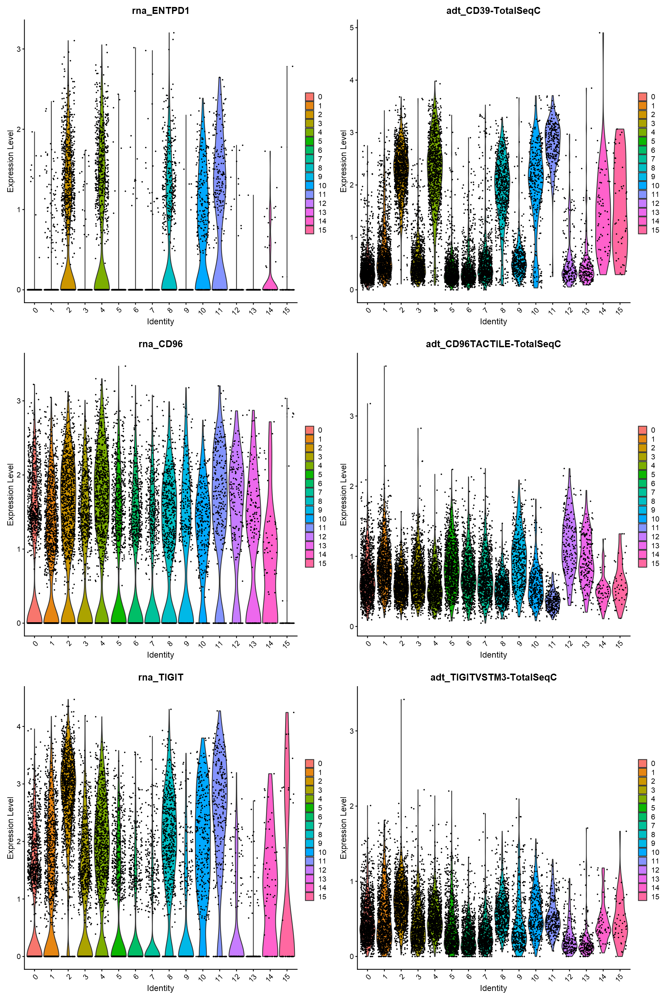

In [15]:
# Plot RNA and protein side by side
cat("Violin plots for expression levels of RNA and protein side by side")
## Arrange multiple violin plots into a grid using cowplot::plot_grid()
cowplot::plot_grid(
  # ENTPD1 RNA and protein CD39-TotalSeqC
   Seurat::VlnPlot(object=merged_seurat, features = genes.selected.RNA[4])
  ,Seurat::VlnPlot(object=merged_seurat, features = protein.selected.ADT[4])
   # CD 96 RNA and CD96TACTILE-TotalSeqC protein 
  ,Seurat::VlnPlot(object=merged_seurat, features = genes.selected.RNA[5])
  ,Seurat::VlnPlot(object=merged_seurat, features = protein.selected.ADT[5])
   # TIGIT RNA and protein TIGITVSTM3-TotalSeqC
  ,Seurat::VlnPlot(object=merged_seurat, features = genes.selected.RNA[6])
  ,Seurat::VlnPlot(object=merged_seurat, features = protein.selected.ADT[6]) 
  ,ncol=2)

Violin plots for RNA gene expression between conditions stimulated and unstimulated

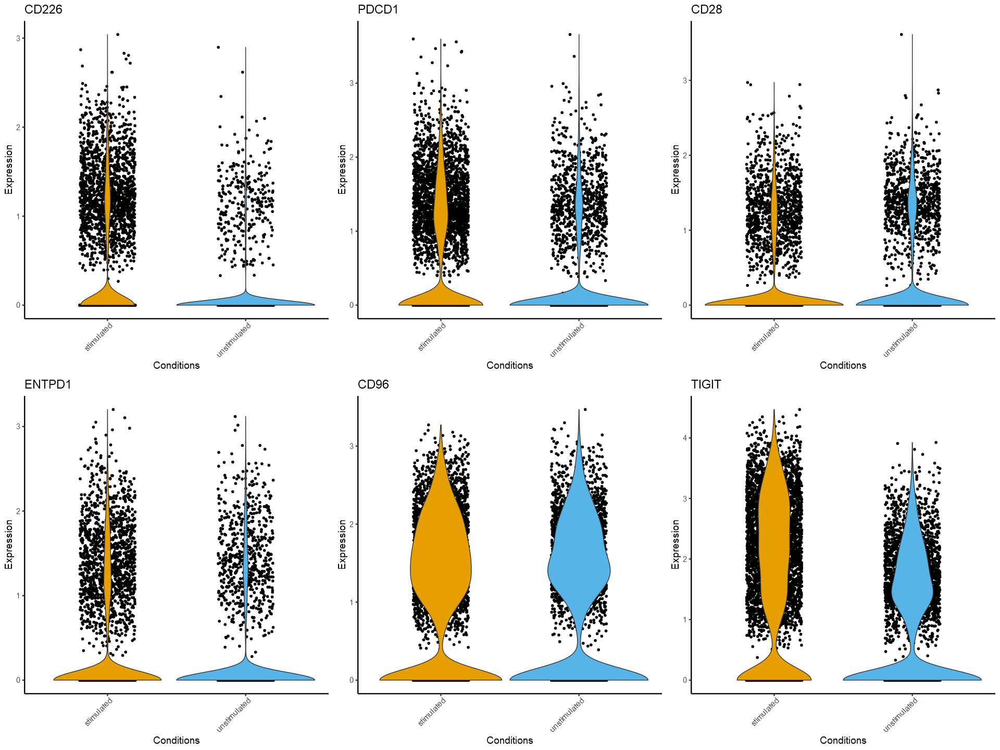

In [16]:
# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 3*expansion.factor)
cat("Violin plots for RNA gene expression between conditions stimulated and unstimulated")
dittoSeq::multi_dittoPlot(object= merged_seurat
                          , assay="RNA"
                          , var= genes.selected # c(genes.selected.RNA, genes.selected.ADT) 
                          , group.by = "condition"
                          , vlnplot.lineweight = 0.3
                          , jitter.size = 1
                          ,legend.show = FALSE
                          ,xlab = "Conditions"
                          ,ylab = "Expression") # CD226, TIGIT have higher expression in stim than unsti; EOMES

tSNE plots for expression of RNA and protien between conditions stimulated and unstimulated

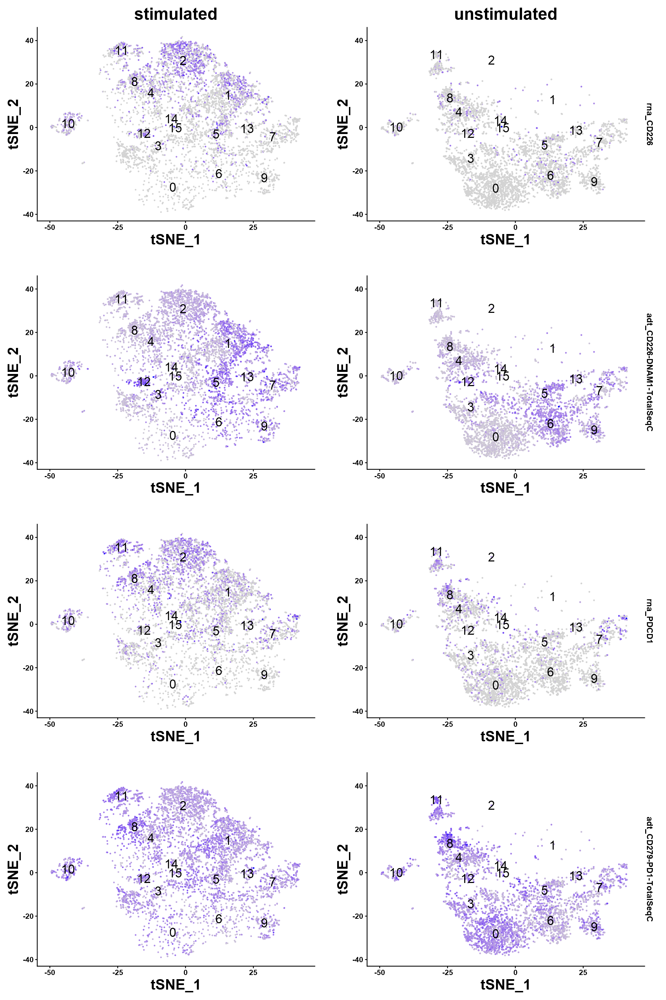

In [17]:
# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 6*expansion.factor)

# CD226, CDPD1 gene and protein expression between conditions
cat("tSNE plots for expression of RNA and protien between conditions stimulated and unstimulated")
Seurat::FeaturePlot(object=merged_seurat
                    , features = c( genes.selected.RNA[1], protein.selected.ADT[1]
                                   ,genes.selected.RNA[2], protein.selected.ADT[2])
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    , split.by = "condition"
                    ) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

tSNE plots for expression of RNA and protien between conditions stimulated and unstimulated

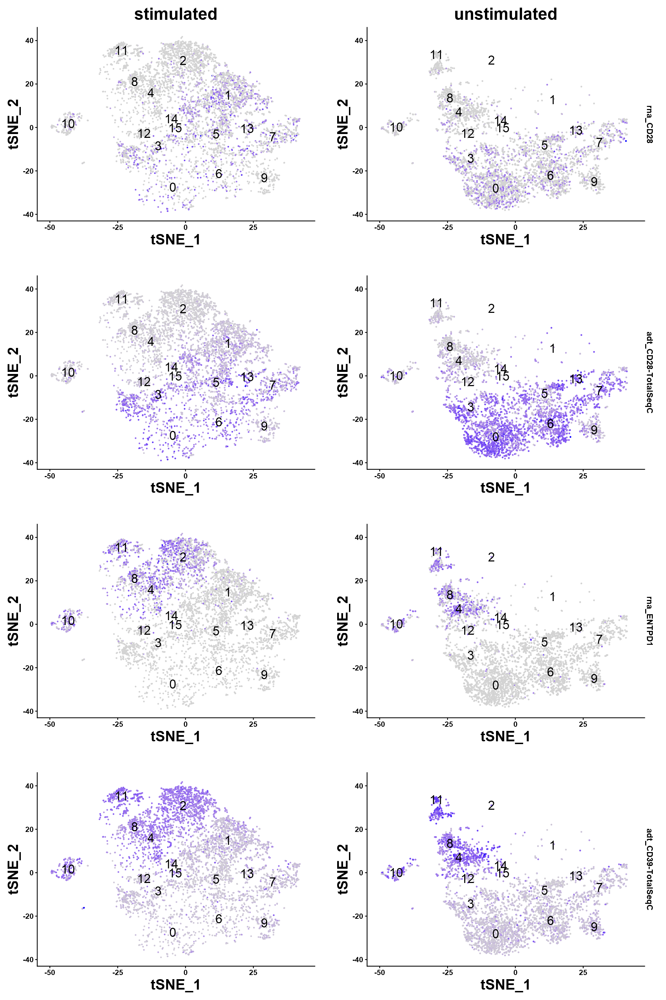

In [18]:
# CD28, ENTPD1 gene and protein expression between conditions
cat("tSNE plots for expression of RNA and protien between conditions stimulated and unstimulated")
Seurat::FeaturePlot(object=merged_seurat
                    , features = c( genes.selected.RNA[3], protein.selected.ADT[3]
                                   ,genes.selected.RNA[4], protein.selected.ADT[4])
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    , split.by = "condition"
                    ) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

tSNE plots for expression of RNA and protien between conditions stimulated and unstimulated

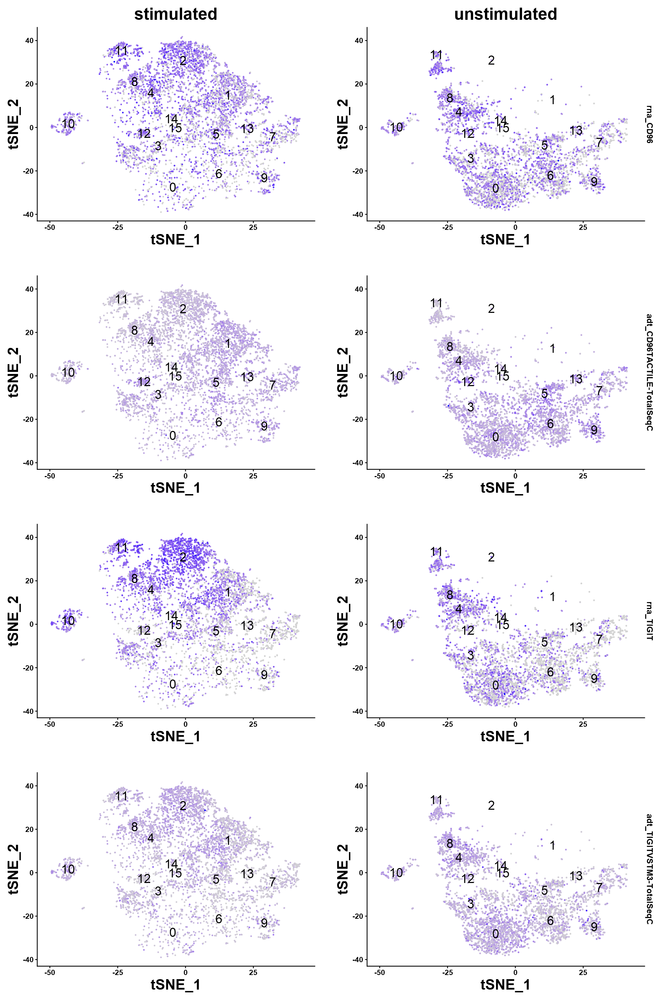

In [19]:
# CD96, TIGIT gene and protein expression between conditions
cat("tSNE plots for expression of RNA and protien between conditions stimulated and unstimulated")
Seurat::FeaturePlot(object=merged_seurat
                    , features = c( genes.selected.RNA[5], protein.selected.ADT[5]
                                   ,genes.selected.RNA[6], protein.selected.ADT[6])
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    , split.by = "condition"
                    ) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

## Identify potential marker genes for each cluster

This type of analysis is typically recommended for when evaluating a single sample group/condition. With the ` FindAllMarkers()` function we are comparing each cluster against all other clusters to identify potential marker genes. The cells in each cluster are treated as replicates, and essentially a differential expression analysis is performed with some statistical test.

NOTE: The default is a Wilcoxon Rank Sum test, but there are other options available.

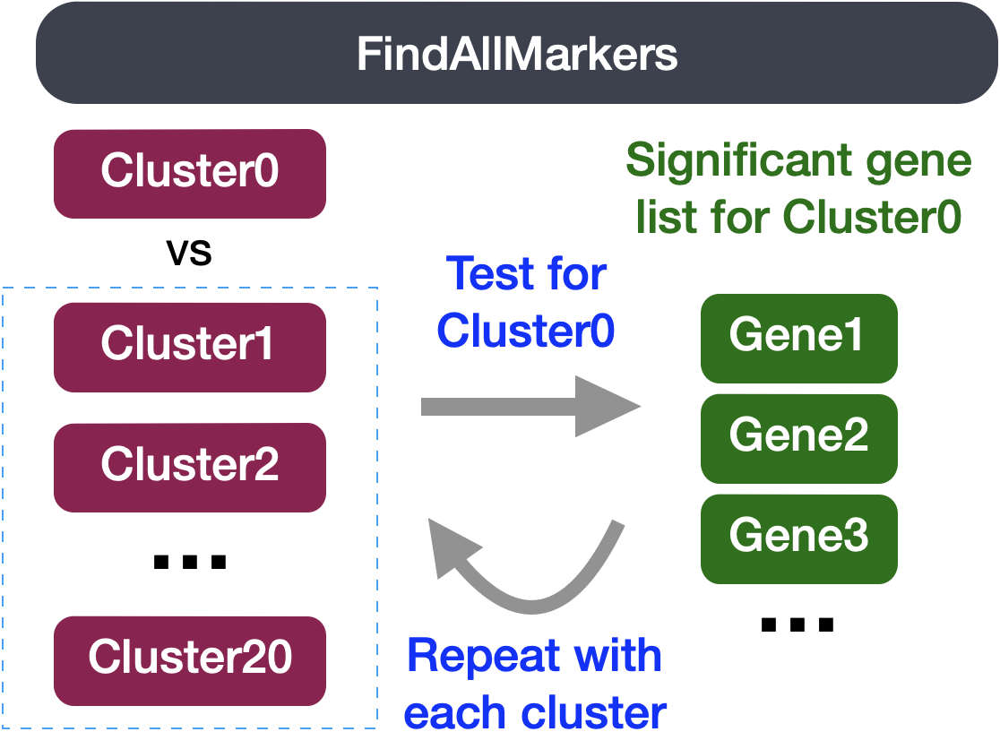

In [20]:
# Find markers for every cluster compared to all remaining cells, report only the positive ones
cat("Identify differentially expressed genes for each cluster")
markers <- Seurat::FindAllMarkers(object=merged_seurat
                                  ,min.pct=0.25
                                  ,only.pos = TRUE
                                  ,logfc.threshold = 0.25
                                  ,verbose=FALSE)

Identify differentially expressed genes for each cluster

## Identify gene markers that are conserved between the groups

Since we have samples representing different conditions in our dataset, our best option is to find conserved markers. This function internally separates out cells by sample group/condition, and then performs differential gene expression testing for a single specified cluster against all other clusters (or a second cluster, if specified). Gene-level p-values are computed for each condition and then combined across groups using meta-analysis methods from the MetaDE R package.

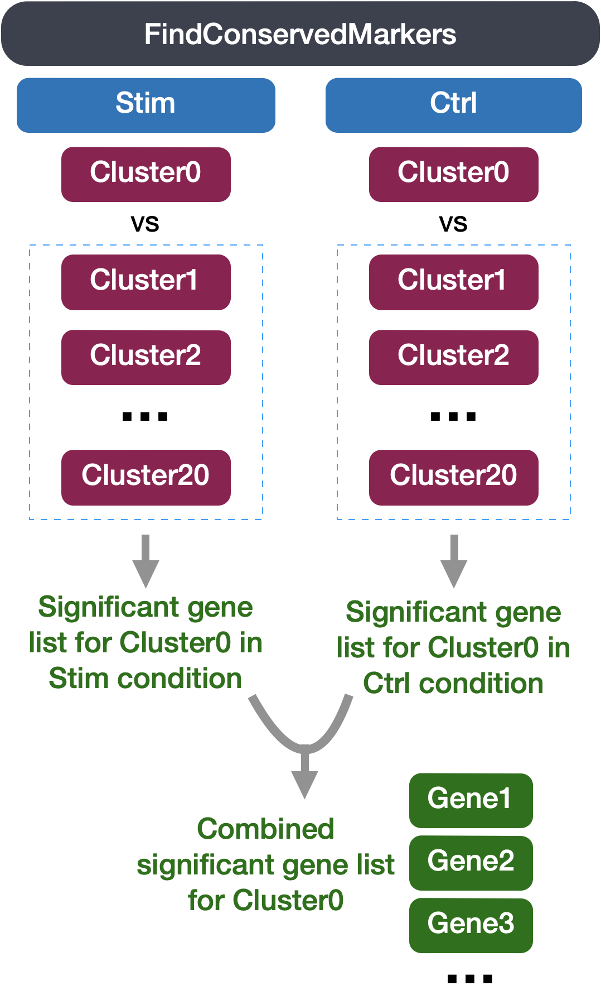

In [21]:
cluster0_conserved_markers <- Seurat::FindConservedMarkers(merged_seurat
                                                           ,ident.1 = 0
                                                           ,grouping.var = "condition"
                                                           ,only.pos = TRUE
                                                           ,logfc.threshold = 0.25)
head(cluster0_conserved_markers)

Testing group unstimulated: (0) vs (10, 4, 7, 8, 6, 9, 5, 12, 13, 3, 14, 15, 1, 2, 11)

Testing group stimulated: (0) vs (2, 7, 3, 5, 1, 6, 10, 11, 4, 13, 9, 14, 15, 12, 8)



,unstimulated_p_val,unstimulated_avg_log2FC,unstimulated_pct.1,unstimulated_pct.2,unstimulated_p_val_adj,stimulated_p_val,stimulated_avg_log2FC,stimulated_pct.1,stimulated_pct.2,stimulated_p_val_adj,max_pval,minimump_p_val
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
GZMK,5.659935e-265,1.741423,0.825,0.296,9.224562e-261,1.522696e-71,1.9109346,0.732,0.266,2.481690e-67,1.522696e-71,1.131987e-264
CMC1,8.986527e-163,1.509320,0.618,0.242,1.464624e-158,3.240914e-48,1.3044352,0.614,0.243,5.282042e-44,3.240914e-48,1.797305e-162
CST7,9.525578e-154,1.074360,0.951,0.770,1.552479e-149,1.327403e-34,0.9268426,0.950,0.837,2.163401e-30,1.327403e-34,1.905116e-153
EOMES,1.408120e-151,1.300099,0.538,0.175,2.294955e-147,5.301662e-37,1.2112108,0.423,0.140,8.640648e-33,5.301662e-37,2.816241e-151
RPS15A,1.118059e-122,0.462811,0.999,0.997,1.822213e-118,3.793634e-33,0.5146104,1.000,0.996,6.182865e-29,3.793634e-33,2.236118e-122
DKK3,1.390575e-108,1.218504,0.329,0.072,2.266358e-104,1.375378e-53,1.2423714,0.309,0.055,2.241592e-49,1.375378e-53,2.781149e-108


In [22]:
merged_seurat_0.1 <- Seurat::FindClusters(merged_seurat, resolution = 0.1, verbose=FALSE)
merged_seurat_0.2 <- Seurat::FindClusters(merged_seurat, resolution = 0.2, verbose=FALSE)
merged_seurat_0.3 <- Seurat::FindClusters(merged_seurat, resolution = 0.3, verbose=FALSE)
merged_seurat_0.4 <- Seurat::FindClusters(merged_seurat, resolution = 0.4, verbose=FALSE)
merged_seurat_0.5 <- Seurat::FindClusters(merged_seurat, resolution = 0.5, verbose=FALSE)
merged_seurat_0.6 <- Seurat::FindClusters(merged_seurat, resolution = 0.6, verbose=FALSE)
merged_seurat_0.7 <- Seurat::FindClusters(merged_seurat, resolution = 0.7, verbose=FALSE)
merged_seurat_0.8 <- Seurat::FindClusters(merged_seurat, resolution = 0.8, verbose=FALSE)
merged_seurat_0.9 <- Seurat::FindClusters(merged_seurat, resolution = 0.9, verbose=FALSE)
merged_seurat_1.0 <- Seurat::FindClusters(merged_seurat, resolution = 1.0, verbose=FALSE)
merged_seurat_1.1 <- Seurat::FindClusters(merged_seurat, resolution = 1.1, verbose=FALSE)
merged_seurat_1.2 <- Seurat::FindClusters(merged_seurat, resolution = 1.2, verbose=FALSE)

p1 <- Seurat::DimPlot(merged_seurat_0.1, reduction = "tsne")+ ggplot2::ggtitle("resol_0.1")
p2 <- Seurat::DimPlot(merged_seurat_0.2, reduction = "tsne")+ ggplot2::ggtitle("resol_0.2")
p3 <- Seurat::DimPlot(merged_seurat_0.3, reduction = "tsne")+ ggplot2::ggtitle("resol_0.3")
p4 <- Seurat::DimPlot(merged_seurat_0.4, reduction = "tsne")+ ggplot2::ggtitle("resol_0.4")
p5 <- Seurat::DimPlot(merged_seurat_0.5, reduction = "tsne")+ ggplot2::ggtitle("resol_0.5")
p6 <- Seurat::DimPlot(merged_seurat_0.6, reduction = "tsne")+ ggplot2::ggtitle("resol_0.6")
p7 <- Seurat::DimPlot(merged_seurat_0.7, reduction = "tsne")+ ggplot2::ggtitle("resol_0.7")
p8 <- Seurat::DimPlot(merged_seurat_0.8, reduction = "tsne")+ ggplot2::ggtitle("resol_0.8")
p9 <- Seurat::DimPlot(merged_seurat_0.9, reduction = "tsne")+ ggplot2::ggtitle("resol_0.9")
p10 <- Seurat::DimPlot(merged_seurat_1.0, reduction = "tsne")+ ggplot2::ggtitle("resol_1.0")
p11 <- Seurat::DimPlot(merged_seurat_1.1, reduction = "tsne")+ ggplot2::ggtitle("resol_1.1")
p12 <- Seurat::DimPlot(merged_seurat_1.2, reduction = "tsne")+ ggplot2::ggtitle("resol_1.2")

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


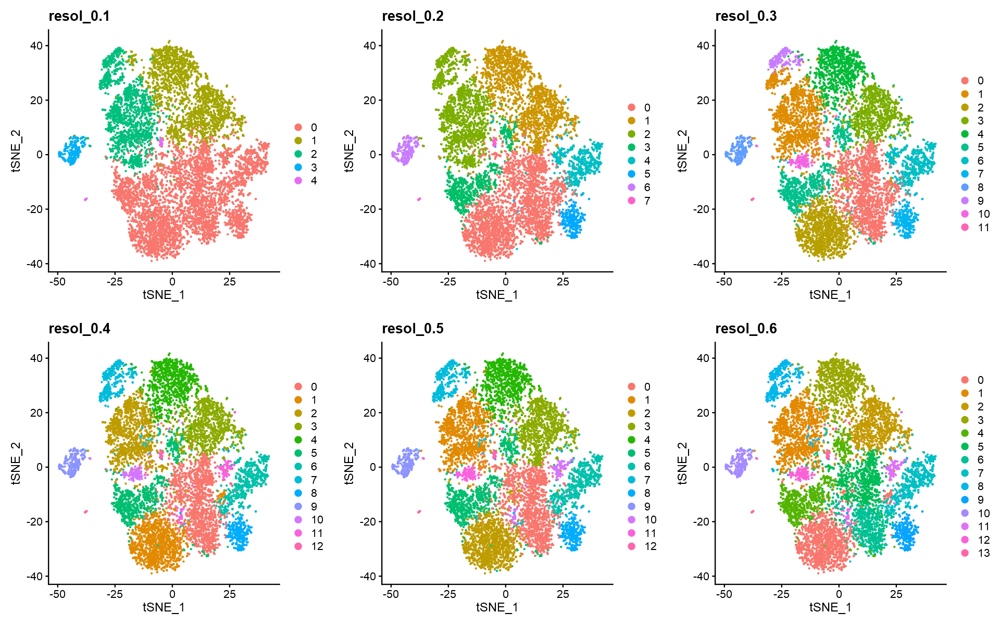

In [23]:
# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 2.5*expansion.factor)

Seurat::CombinePlots(plots = list(p1, p2,p3,p4,p5,p6))

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


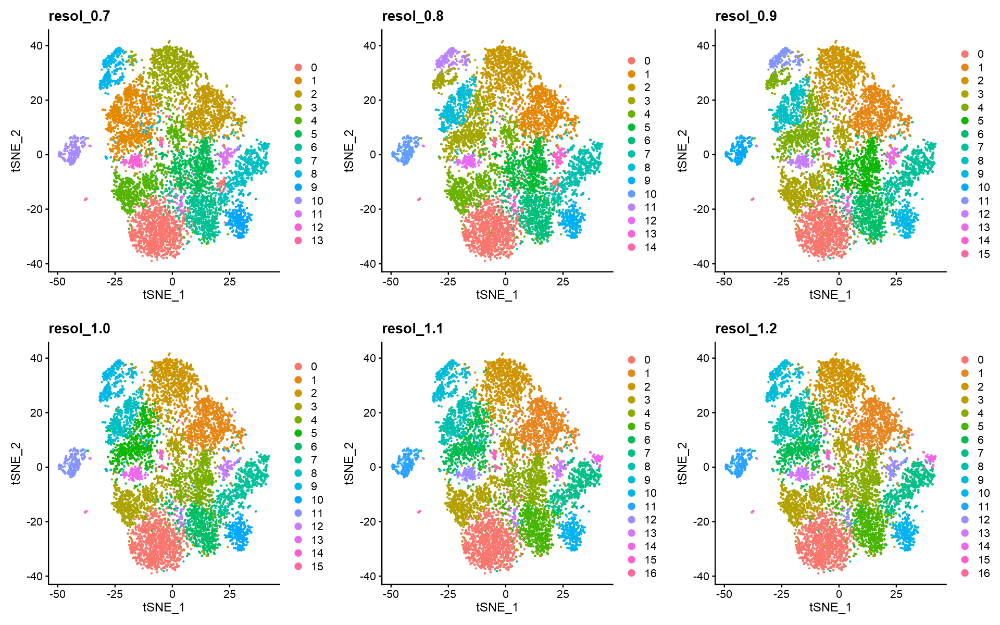

In [24]:
Seurat::CombinePlots(plots = list(p7,p8,p9,p10,p11,p12))

In [25]:
p1 <- Seurat::DimPlot(merged_seurat_0.1, reduction = "umap")+ ggplot2::ggtitle("resol_0.1")
p2 <- Seurat::DimPlot(merged_seurat_0.2, reduction = "umap")+ ggplot2::ggtitle("resol_0.2")
p3 <- Seurat::DimPlot(merged_seurat_0.3, reduction = "umap")+ ggplot2::ggtitle("resol_0.3")
p4 <- Seurat::DimPlot(merged_seurat_0.4, reduction = "umap")+ ggplot2::ggtitle("resol_0.4")
p5 <- Seurat::DimPlot(merged_seurat_0.5, reduction = "umap")+ ggplot2::ggtitle("resol_0.5")
p6 <- Seurat::DimPlot(merged_seurat_0.6, reduction = "umap")+ ggplot2::ggtitle("resol_0.6")
p7 <- Seurat::DimPlot(merged_seurat_0.7, reduction = "umap")+ ggplot2::ggtitle("resol_0.7")
p8 <- Seurat::DimPlot(merged_seurat_0.8, reduction = "umap")+ ggplot2::ggtitle("resol_0.8")
p9 <- Seurat::DimPlot(merged_seurat_0.9, reduction = "umap")+ ggplot2::ggtitle("resol_0.9")
p10 <- Seurat::DimPlot(merged_seurat_1.0, reduction = "umap")+ ggplot2::ggtitle("resol_1.0")
p11 <- Seurat::DimPlot(merged_seurat_1.1, reduction = "umap")+ ggplot2::ggtitle("resol_1.1")
p12 <- Seurat::DimPlot(merged_seurat_1.2, reduction = "umap")+ ggplot2::ggtitle("resol_1.2")

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


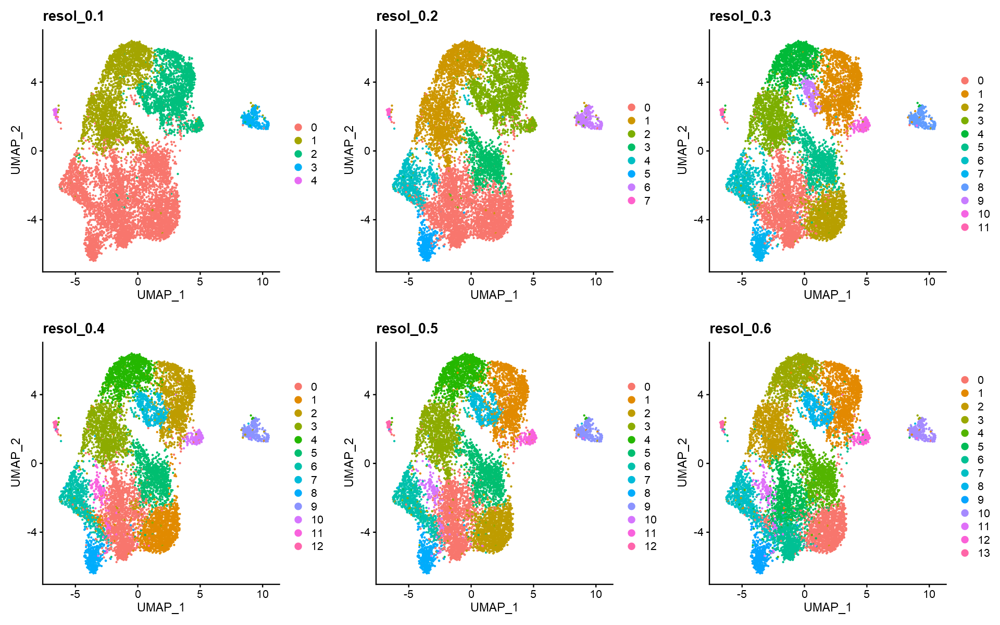

In [26]:
Seurat::CombinePlots(plots = list(p1, p2,p3,p4,p5,p6))

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


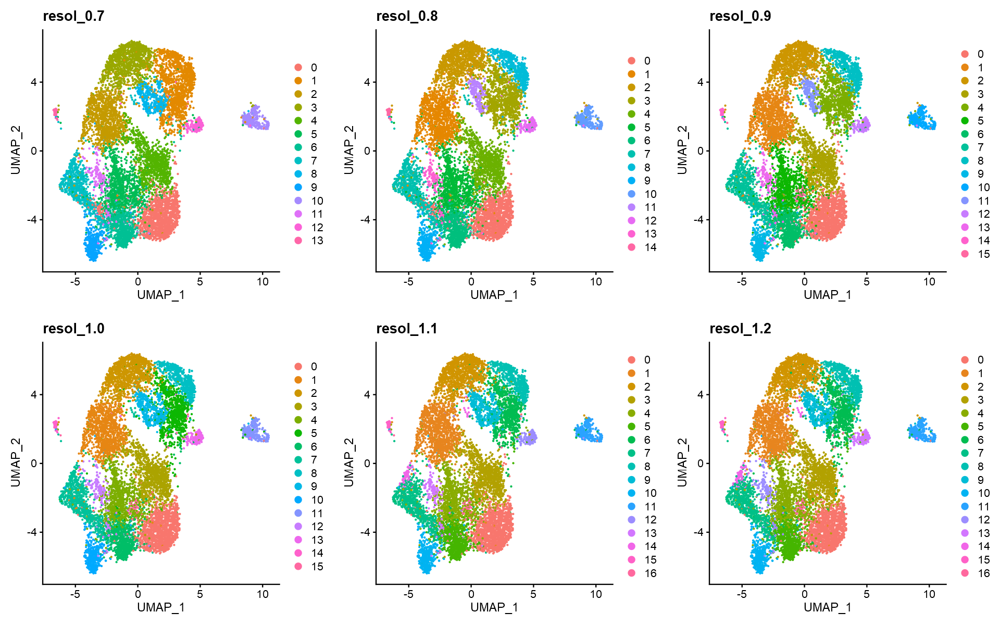

In [27]:
Seurat::CombinePlots(plots = list(p7,p8,p9,p10,p11,p12))

In [28]:
# Find markers for every cluster compared to all remaining cells, report only the positive ones
cat("Identify differentially expressed genes for each cluster")
markers_0.5 <- Seurat::FindAllMarkers(object= merged_seurat_0.5
                                  ,min.pct=0.25
                                  ,only.pos = TRUE
                                  ,logfc.threshold = 0.25
                                  ,verbose=FALSE)
head(markers_0.5)

Identify differentially expressed genes for each cluster

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
IL7R,9.678977e-268,1.3660222,0.856,0.519,1.577480e-263,0,IL7R
RPS12,1.887499e-254,0.5962669,0.998,0.998,3.076247e-250,0,RPS12
RPL32,9.104873e-237,0.5486433,0.995,0.998,1.483912e-232,0,RPL32
RPL10,2.111811e-234,0.5273115,0.995,0.999,3.441830e-230,0,RPL10
RPS3A,1.218826e-225,0.5881000,0.991,0.996,1.986442e-221,0,RPS3A
RPL34,9.950714e-223,0.5902106,0.984,0.995,1.621767e-218,0,RPL34


In [29]:
write.table(markers_0.5, "E:/backup-genomeinfo/share/analysis/Bald_-_RNASeq/scRNA_Feb2020_CITE_VDJ/GEX_CiteSeq/analysis-results/FindAllMarkers_resolution-0.5.txt"
            , sep = "\t", row.names = F)

In [30]:
top10 <- markers_0.5 %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)
head(top10)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
9.678977e-268,1.3660222,0.856,0.519,1.577480e-263,0,IL7R
1.887499e-254,0.5962669,0.998,0.998,3.076247e-250,0,RPS12
6.742727e-164,1.0233487,0.942,0.918,1.098930e-159,0,PABPC1
5.589620e-146,1.3356441,0.982,0.985,9.109963e-142,0,FTH1
4.438425e-135,0.8232958,0.850,0.680,7.233745e-131,0,ZFP36L2
2.077494e-100,0.7098626,0.818,0.665,3.385900e-96,0,ZFP36


Warning message in Seurat::DoHeatmap(subset(merged_seurat_0.5, downsample = 100), :
"The following features were omitted as they were not found in the scale.data slot for the RNA assay: SPOCK2, SPINT2, SAMD3, CLDND1, CST7, ADK, RPS12"


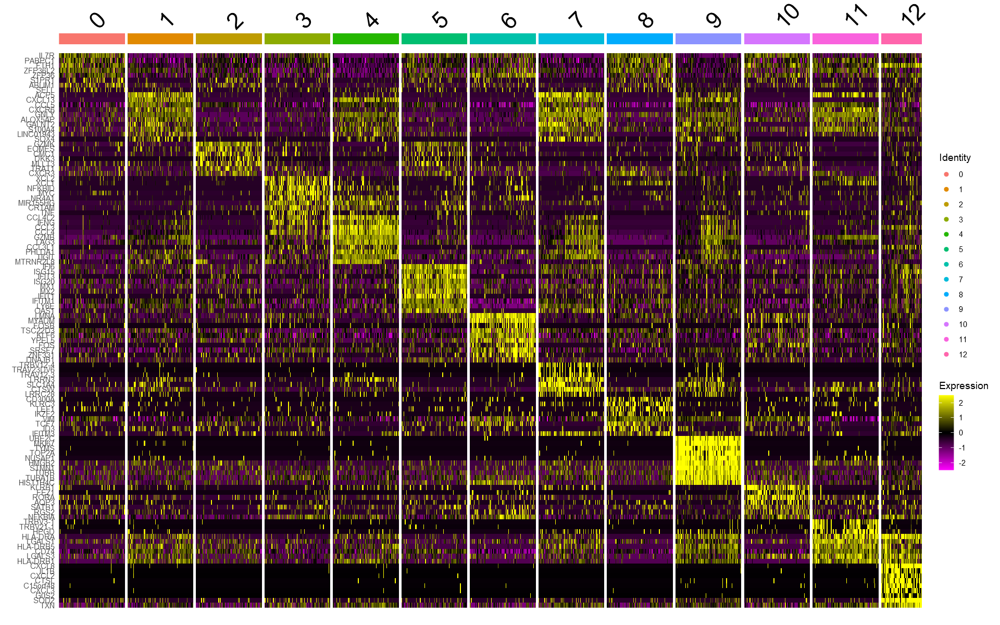

In [31]:
Seurat::DoHeatmap( subset(merged_seurat_0.5, downsample = 100)
                  ,features = top10$gene
                  , size = 9
                  ,assay = "RNA")

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C01-LEF1 cluster

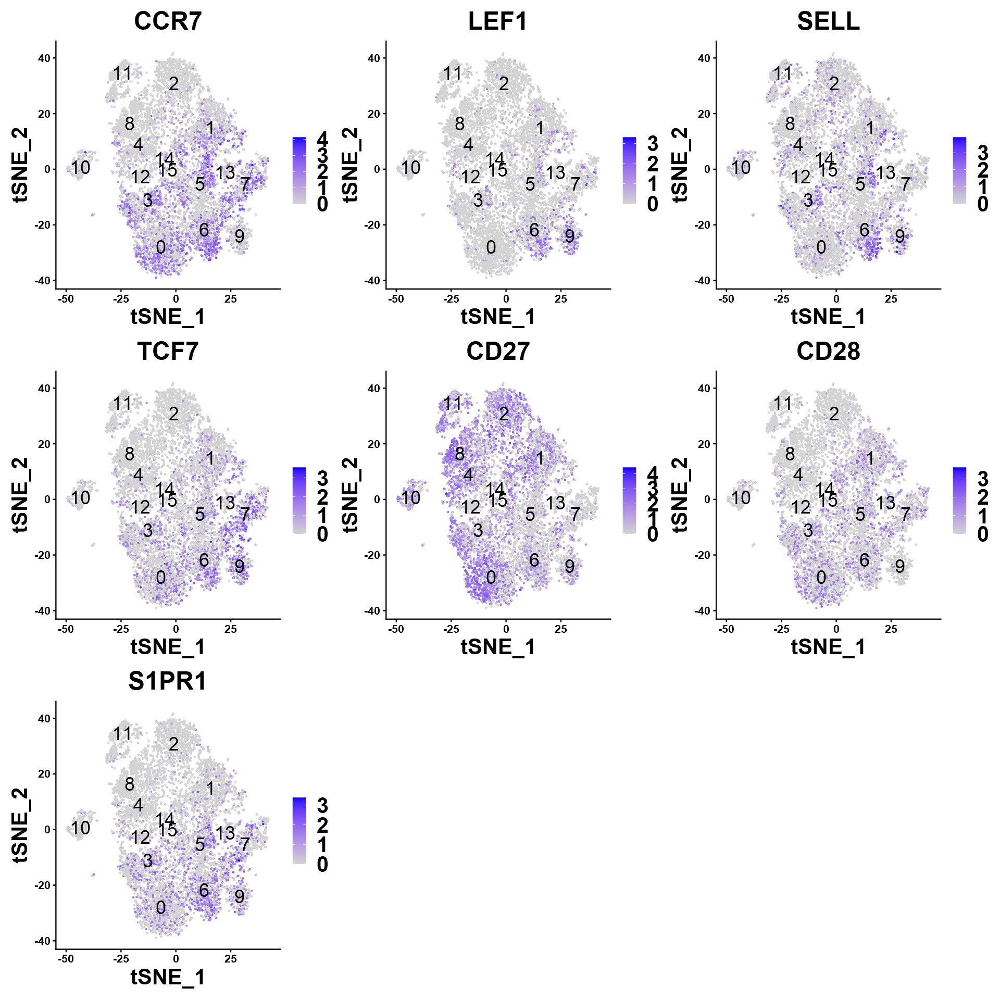

In [32]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C01-LEF1 cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
genes.repre.CD8.cluster.1 <- c("CCR7","LEF1","SELL","TCF7","CD27","CD28","S1PR1")
genes.repre.CD8.cluster.1 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 4*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C01-LEF1 cluster")
Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.1
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
                    ) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C02-GPR183 cluster

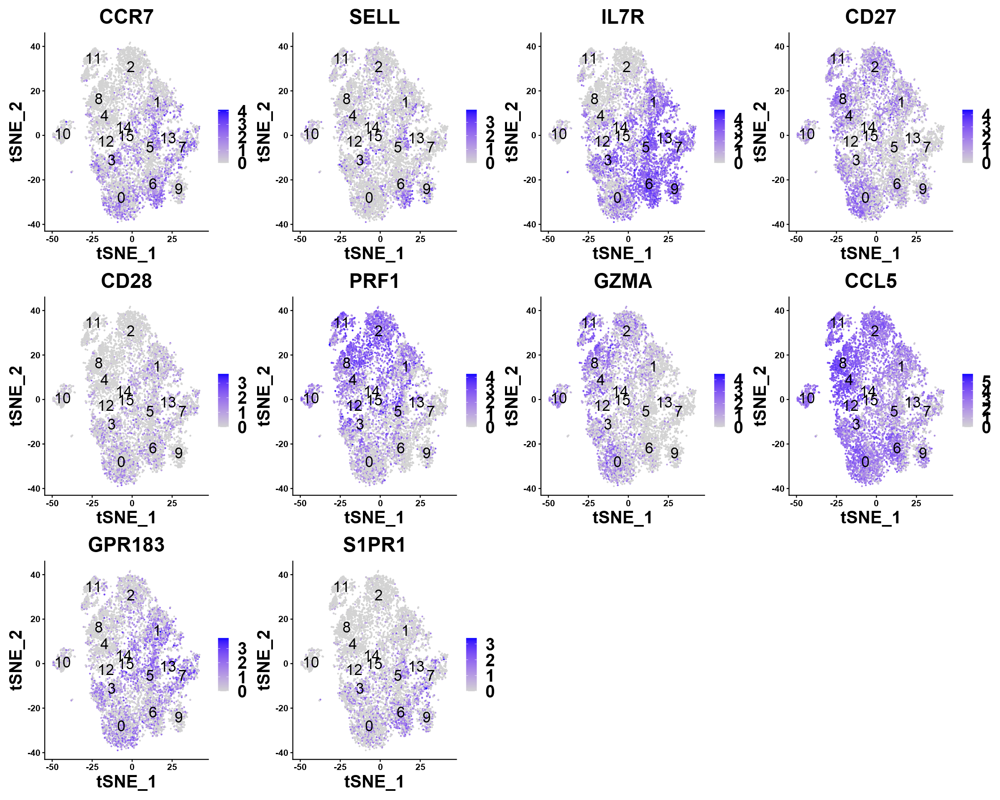

In [33]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C02-GPR183 cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
genes.repre.CD8.cluster.2 <- c("CCR7","SELL","IL7R","CD27","CD28","PRF1","GZMA","CCL5","GPR183","S1PR1")
genes.repre.CD8.cluster.2 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 5*expansion.factor, repr.plot.height = 4*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C02-GPR183 cluster")

Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.2
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C03-CX3CR1 cluster

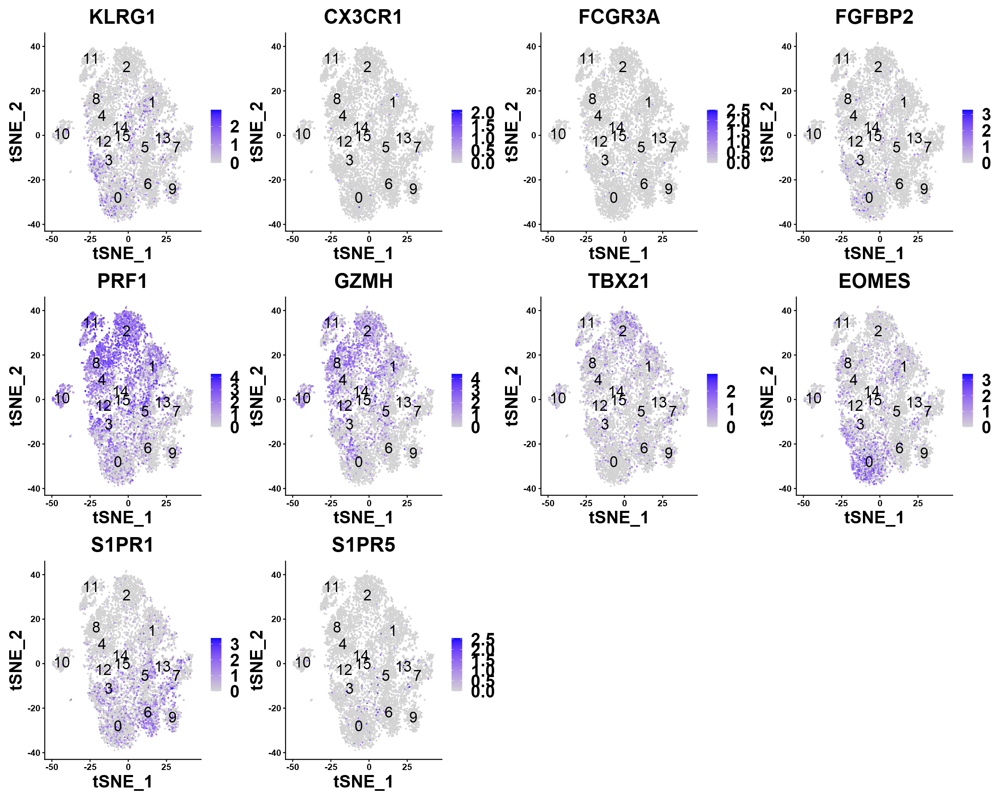

In [34]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C03-CX3CR1 cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
genes.repre.CD8.cluster.3 <- c("KLRG1","CX3CR1","FCGR3A","FGFBP2","PRF1","GZMH","TBX21","EOMES","S1PR1","S1PR5")
genes.repre.CD8.cluster.3 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 5*expansion.factor, repr.plot.height = 4*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C03-CX3CR1 cluster")

Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.3
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

[1] TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C04-GZMK cluster

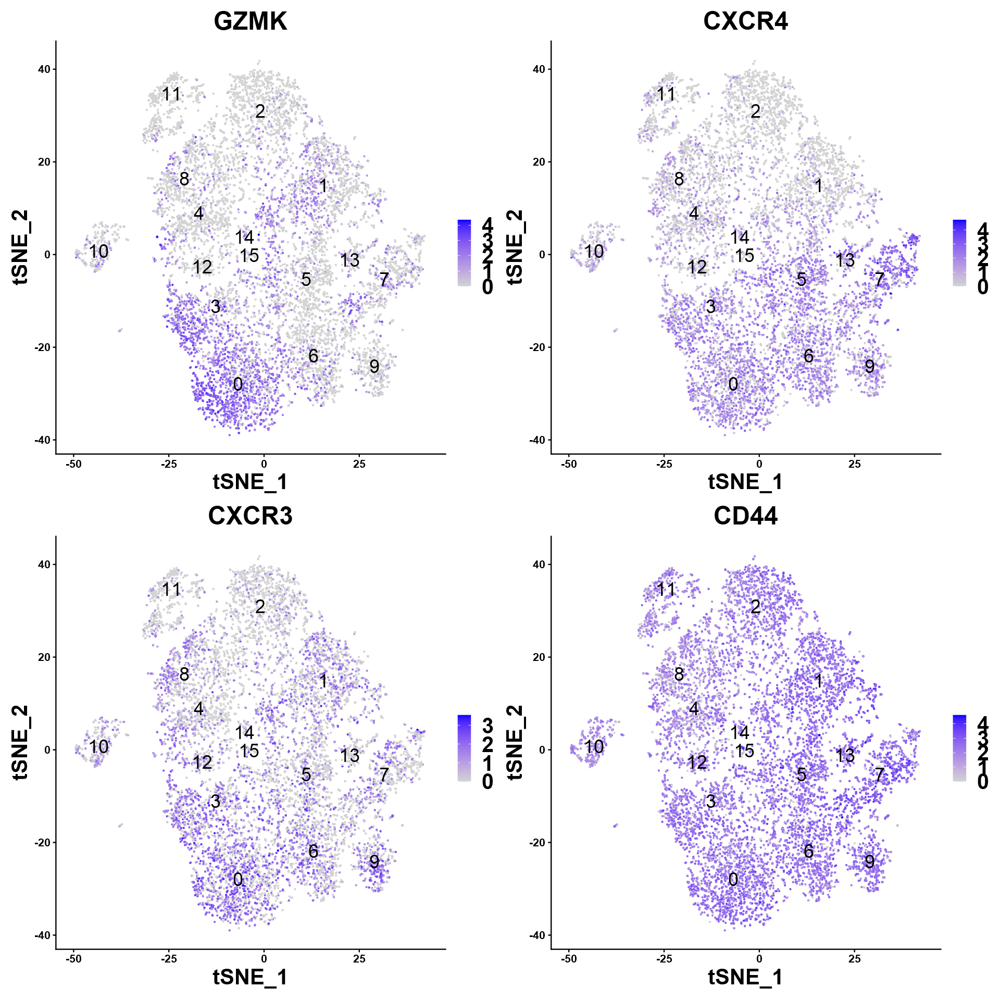

In [35]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C04-GZMK cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
genes.repre.CD8.cluster.4 <- c("GZMK","CXCR4","CXCR3","CD44")
genes.repre.CD8.cluster.4 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 4*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C04-GZMK cluster")

Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.4
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C05-CD6 cluster

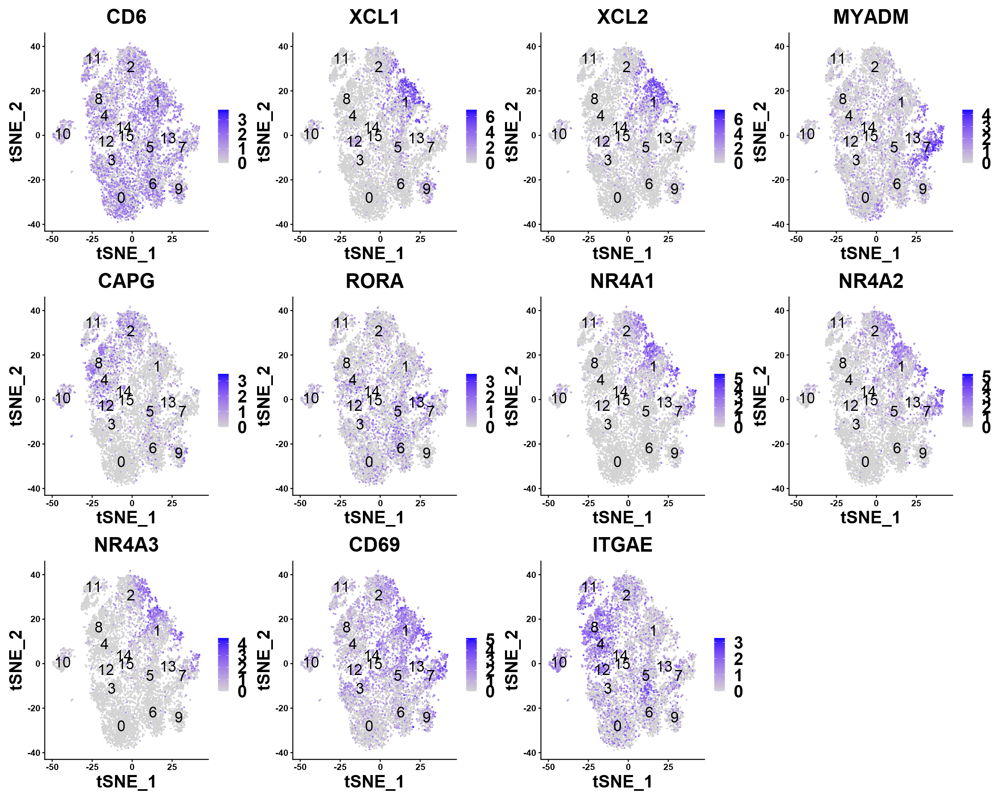

In [36]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C05-CD6 cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
# The gene NR4A1/2/3 is not found. Close genes are [1] "NR4A2" "NR4A3" "NR4A1"
genes.repre.CD8.cluster.5 <- c("CD6","XCL1","XCL2","MYADM","CAPG","RORA","NR4A1","NR4A2","NR4A3","CD69","ITGAE")
genes.repre.CD8.cluster.5 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 5*expansion.factor, repr.plot.height = 4*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C05-CD6 cluster")

Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.5
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

[1] "KLRC4-KLRK1" "KLRC4"       "KLRC3"       "KLRC2"       "KLRC1"

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C06-CD160 cluster

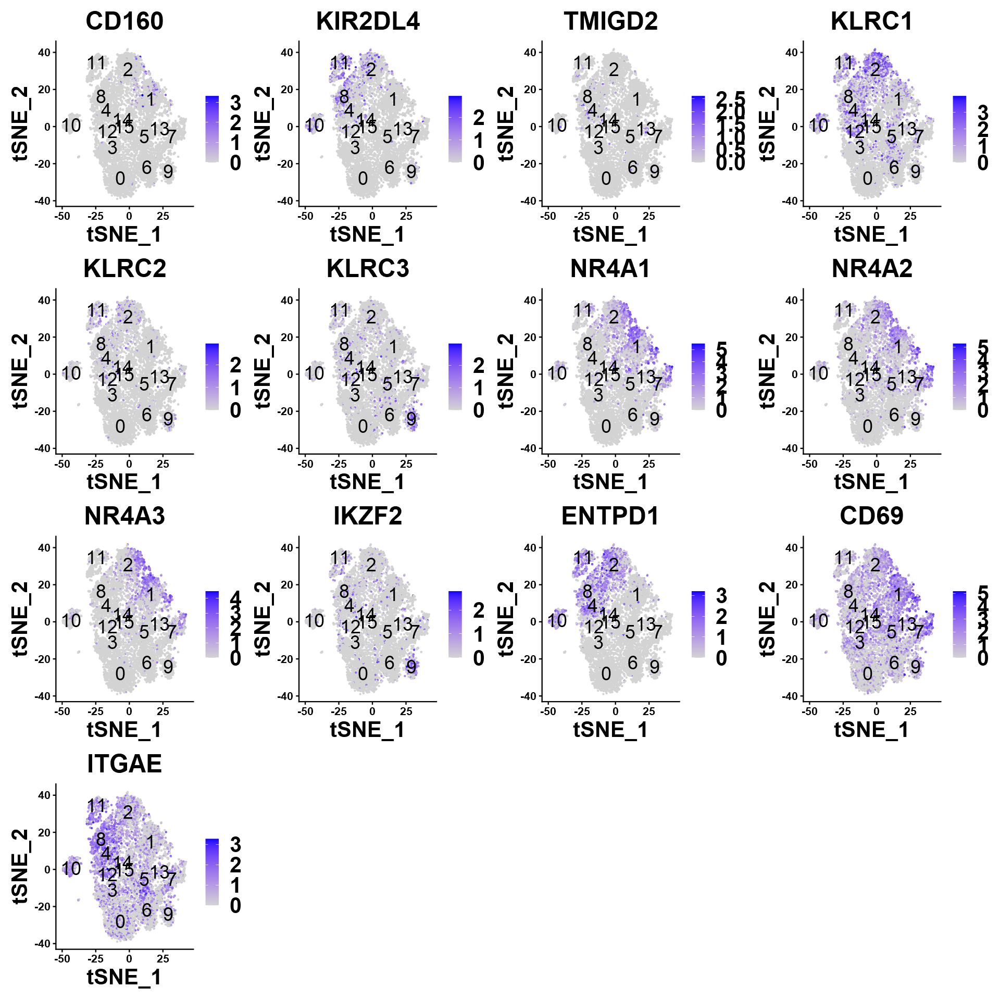

In [37]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C06-CD160 cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
grep(pattern = "KLRC.*", x=rownames(merged_seurat), value = TRUE)
# The gene KLRC1/2/3 is not found. Close genes are [1] "KLRC4-KLRK1" "KLRC4" "KLRC3" "KLRC2" "KLRC1"  
# The gene NR4A1/2/3 is not found. Close genes are [1] "NR4A2" "NR4A3" "NR4A1"

genes.repre.CD8.cluster.6 <- c("CD160","KIR2DL4","TMIGD2","KLRC1","KLRC2","KLRC3","NR4A1","NR4A2","NR4A3","IKZF2","ENTPD1","CD69","ITGAE")
genes.repre.CD8.cluster.6 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 4*expansion.factor, repr.plot.height = 4*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C06-CD160 cluster")

Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.6
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C07-LAYN cluster

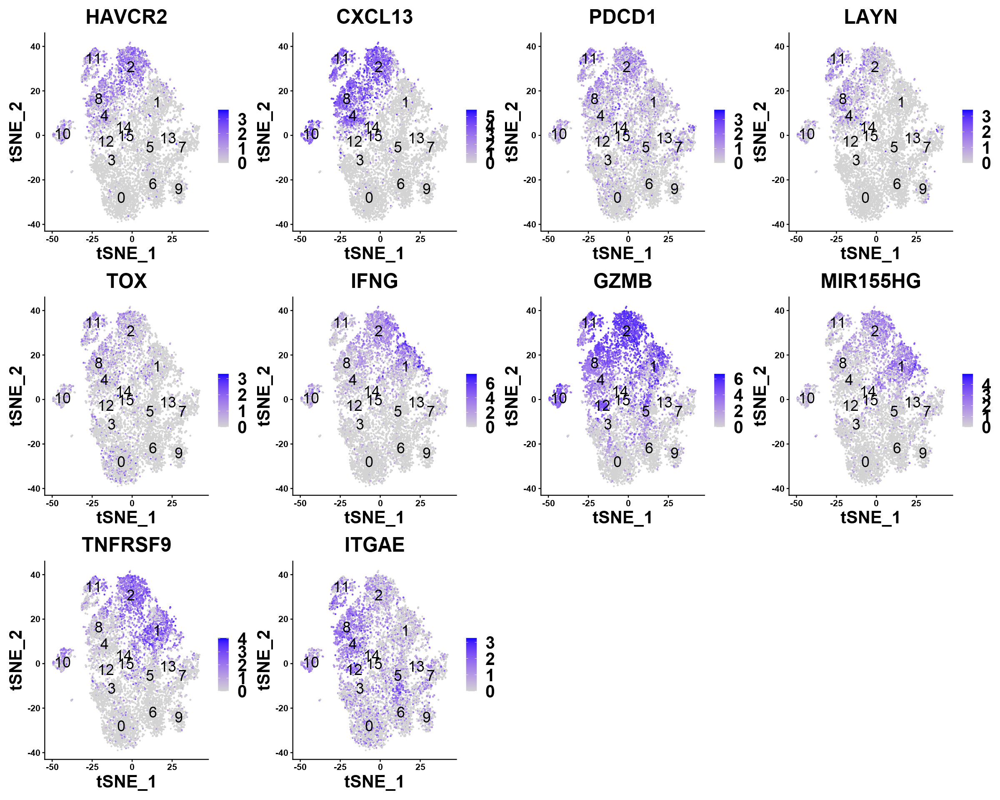

In [38]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C07-LAYN cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
genes.repre.CD8.cluster.7 <- c("HAVCR2","CXCL13","PDCD1","LAYN","TOX","IFNG","GZMB","MIR155HG","TNFRSF9","ITGAE")
genes.repre.CD8.cluster.7 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 5*expansion.factor, repr.plot.height = 4*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C07-LAYN cluster")

Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.7
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))

[1] TRUE TRUE TRUE TRUE TRUE TRUE

Expression of representative genes reported in Zhang's CD8_C08-SLC4A10 cluster

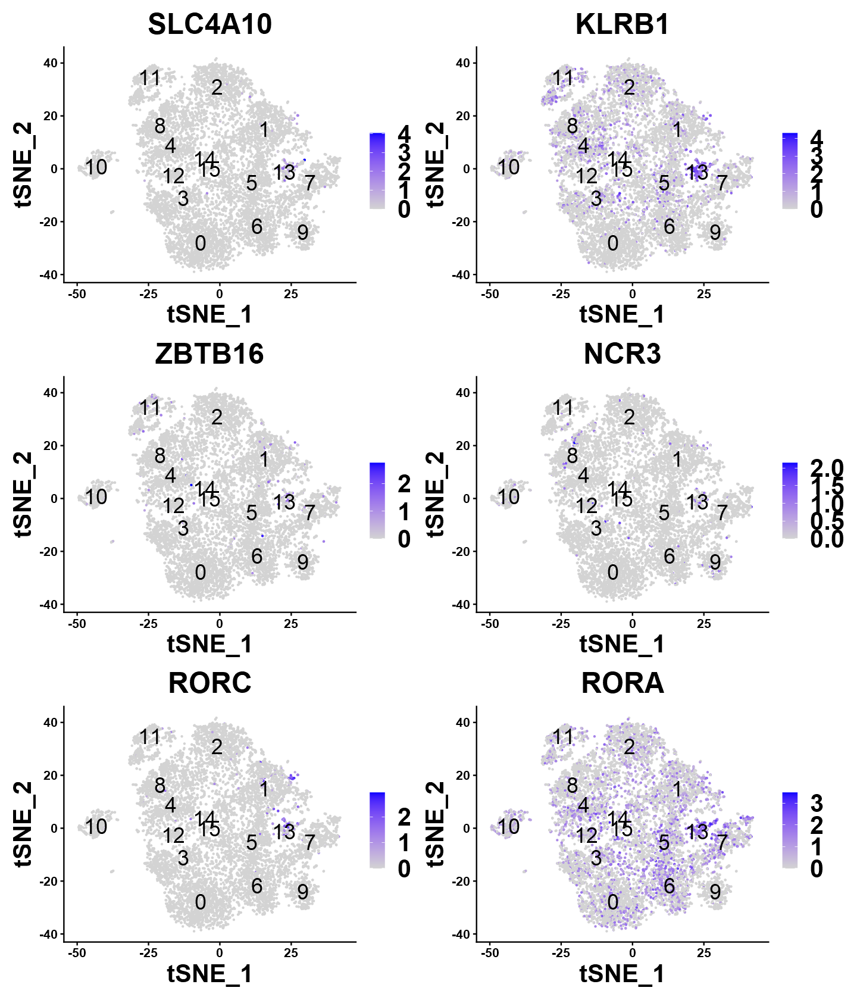

In [39]:
#---------------------------------------------------------------------------------------------------
# Plot expression of representative genes in CD8_C08-SLC4A10 cluster 
# reported in Supplementary table 5, Zhang et al 2018 paper
#---------------------------------------------------------------------------------------------------
genes.repre.CD8.cluster.8 <- c("SLC4A10","KLRB1","ZBTB16","NCR3","RORC","RORA")
genes.repre.CD8.cluster.8 %in% rownames(merged_seurat) # All TRUE

# Chang R plot sizes
expansion.factor <- 4
options(repr.plot.width = 3*expansion.factor, repr.plot.height = 3.5*expansion.factor)

cat("Expression of representative genes reported in Zhang's CD8_C08-SLC4A10 cluster")

Seurat::FeaturePlot(object=merged_seurat
                    , features = genes.repre.CD8.cluster.8
                    , reduction = "tsne"
                    , label = TRUE
                    , label.size = 7.5
                    #, split.by = "condition"
) & ggplot2::theme(text = ggplot2::element_text(size = 25, face = "bold")) +
  ggplot2::theme(legend.text=ggplot2::element_text(size=25, color="black"))